<a href="https://colab.research.google.com/github/gcvasconcelos/unb-classification_political_bias/blob/main/tcc_manifestos_4explainability.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install lime
# !pip install simpletransformers 

     |████████████████████████████████| 275 kB 9.3 MB/s 
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=3fdc4c7f77fa511367f35fc3dfcc5a6d8c7356bb05d84f76c58aa651d93aba61
  Stored in directory: /root/.cache/pip/wheels/ca/cb/e5/ac701e12d365a08917bf4c6171c0961bc880a8181359c66aa7
Successfully built lime


In [25]:
import pandas as pd
import ast
import pickle
import time
import math
import numpy as np
import sys
from PIL import Image
# from simpletransformers.classification import ClassificationModel

from lime.lime_text import LimeTextExplainer
from lime import submodular_pick

## Domain Classification

In [52]:
domain_df = pd.read_csv('/content/drive/MyDrive/UnB/TCC/dados_processados/manifestos_sentences_preproc.csv', keep_default_na=False)
domain_df.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90482 entries, 0 to 90481
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   MANIFEST_ID  90482 non-null  object
 1   TEXT         90482 non-null  object
 2   TEXT_TOKEN   90482 non-null  object
 3   TEXT_LEMMA   90482 non-null  object
 4   DOMAIN_CODE  90482 non-null  int64 
 5   DOMAIN_NAME  90482 non-null  object
 6   CODE         90482 non-null  object
 7   LABEL        90482 non-null  object
dtypes: int64(1), object(7)
memory usage: 5.5+ MB


In [53]:
domain_df = domain_df[domain_df['DOMAIN_CODE'] != 0]
domain_df[['DOMAIN_CODE', 'DOMAIN_NAME']].value_counts()

DOMAIN_CODE  DOMAIN_NAME                
5            Welfare and Quality of Life    25709
4            Economy                        24386
3            Political System                9718
7            Social Groups                   6915
6            Fabric of Society               5527
2            Freedom and Democracy           4989
1            External Relations              4375
dtype: int64

Carrega melhor modelo do experimento e define sua função de probabilidades

In [30]:
!unzip '/content/drive/MyDrive/UnB/TCC/modelos/bertimbau_outputs.zip'

Archive:  /content/drive/MyDrive/UnB/TCC/modelos/bertimbau_outputs.zip
replace content/outputs/checkpoint-6000/scheduler.pt? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [31]:
args = {'no_cache': True, 'use_cached_eval_features': False, 'reprocess_input_data': True, 'silent': True}
model = ClassificationModel('bert', 'content/outputs', use_cuda=True, args=args)

# define softmax function
def softmax(x):
    e_x = np.exp(x - np.max(x))
    return e_x / e_x.sum(axis=0)

# define prediction function
def predict_probs(texts):
    predictions = model.predict(texts)
    x = np.array(list(predictions)[1])
    return np.apply_along_axis(softmax, 1, x)

In [54]:
model = pickle.load(open(f"/content/drive/MyDrive/UnB/TCC/modelos/manifestos_DOMAIN_CODE_TEXT_TOKEN_SGDClassifier.model", 'rb'))
# predict_probs = model.decision_function

# define softmax function
def softmax(x):
    e_x = np.exp(x - np.max(x))
    return e_x / e_x.sum(axis=0)

# define prediction function
def predict_probs(texts):
    predictions = model.decision_function(texts)
    return np.apply_along_axis(softmax, 1, predictions)

## Code Classification

In [3]:
code_df = pd.read_csv('/content/drive/MyDrive/UnB/TCC/dados_processados/manifestos_sentences_preproc_v2.csv', keep_default_na=False)
code_df.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 63919 entries, 0 to 63918
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   MANIFEST_ID  63919 non-null  object 
 1   TEXT         63919 non-null  object 
 2   TEXT_TOKEN   63919 non-null  object 
 3   TEXT_LEMMA   63919 non-null  object 
 4   DOMAIN_CODE  63919 non-null  int64  
 5   DOMAIN_NAME  63919 non-null  object 
 6   CODE         63919 non-null  float64
 7   LABEL        63919 non-null  object 
dtypes: float64(1), int64(1), object(6)
memory usage: 3.9+ MB


In [4]:
code_df['CODE'] = code_df['CODE'].astype(str)

In [5]:
code_df[['CODE', 'LABEL']].value_counts()

CODE   LABEL                                
504.0  welfare +                                7787
411.0  technology & infrastructure              7087
506.0  education +                              5199
503.0  equality +                               5015
303.0  gov-admin efficiency                     4644
501.0  environmentalism +                       3840
502.0  culture +                                3013
202.1  democracy: general +                     2848
416.2  sustainability +                         2770
701.0  labour groups +                          2694
410.0  economic growth +                        2539
402.0  incentives                               2273
605.1  law and order +                          2213
703.1  agriculture and farmers +                1999
403.0  market regulation                        1981
414.0  economic orthodoxy                       1740
301.0  decentralisation                         1726
401.0  free market economy                      1219
3

In [6]:
model_code = pickle.load(open(f"/content/drive/MyDrive/UnB/TCC/modelos/manifestos_CODE_TEXT_TOKEN_SGDClassifier.model", 'rb'))
# predict_probs = model_code.decision_function

# define softmax function
def softmax(x):
    e_x = np.exp(x - np.max(x))
    return e_x / e_x.sum(axis=0)

# define prediction function
def predict_probs(texts):
    predictions = model_code.decision_function(texts)
    return np.apply_along_axis(softmax, 1, predictions)

## LIME

## Domain Explanation

In [55]:
text_column = "TEXT_TOKEN"
label_column = "DOMAIN_CODE"

Adaptando código de dominio (1 a 7), para rótulo do modelo treinado (0 a 6)

In [56]:
labels = list(domain_df[label_column].unique()-1)
labels.sort()
labels

[0, 1, 2, 3, 4, 5, 6]

In [57]:
explainer = LimeTextExplainer(class_names=labels)

In [58]:
def create_local_explanation(sample):
    print(f'Create local explanation for document index: {sample.index.item()}')

    class_true = sample[label_column].item() - 1
    print(f'True class:\n\t{class_true+1} - {sample["DOMAIN_NAME"].item()}')

    text = sample[text_column].item()
    class_pred = model.predict([text])[0][0]
    print(f"Predicted class:\n\t{class_pred+1}")
    # print(f'Document text:\n{text}')

    class_idx = []
    class_idx.append(labels.index(class_true))

    # if class was misclassificated, create both explanations
    if class_true != class_pred: 
        class_idx.append(labels.index(class_pred))
        
    exp = explainer.explain_instance(text, predict_probs, num_features=10, labels=class_idx)

    # for cl in class_idx:
    #     print('Explanation for class %s' % labels[cl])
    #     out = [print(f'\t{e}') for e in sorted(exp.as_list(label=cl), key=lambda x: x[1], reverse=True)]

    exp.show_in_notebook()

### 5

In [10]:
class_sample = domain_df[domain_df['DOMAIN_CODE'] == 5].sample(100)
class_sample['DOMAIN_CODE_PRED'] = model.predict(list(class_sample['TEXT_TOKEN']))[0]

In [16]:
sample = class_sample[(class_sample['DOMAIN_CODE'] == 5) & (class_sample['DOMAIN_CODE_PRED'] == 3)].sample(1)
# sample = class_sample[class_sample.index == 27361]
sample

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,DOMAIN_CODE_PRED
27361,180310_199810,"*articular a acao governamental, mobilizando o...",articular acao governamental mobilizando minis...,articular acao governamental mobilizar ministe...,5,Welfare and Quality of Life,506,education +,3


In [17]:
create_local_explanation(sample)

Create local explanation for document index: 27361
True class:
	5 - Welfare and Quality of Life
Predicted class:
	4


In [18]:
class_sample = class_sample[(class_sample['DOMAIN_CODE'] == 5) & (class_sample['DOMAIN_CODE_PRED'] == 4)]
class_sample

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,DOMAIN_CODE_PRED
53317,35211_201510,a pratica e acesso culturais em portugal tem p...,pratica acesso culturais portugal sido frageis...,praticar acesso cultural ser frageis quadrar a...,5,Welfare and Quality of Life,502,culture +,4
51952,35211_201106,este imposto pressupoe um registo patrimonial ...,imposto pressupoe registo patrimonial casos ac...,impor pressupoe registar patrimonial caso acum...,5,Welfare and Quality of Life,503,equality +,4
34935,180310_201010,a proposta serra objetiva criar 1 (hum) milhao...,proposta serra objetiva criar hum milhao matri...,proposto objetiva criar hum milhao matricular ...,5,Welfare and Quality of Life,506,education +,4
43226,180710_199410,"e, como pobre nao tem poder de pressao, os hos...",pobre pressao hospitais publicos deverao entre...,pobre pressao hospital publicos deverao entreg...,5,Welfare and Quality of Life,504,welfare +,4
46411,35110_201910,e o que se exige e o cumprimento da funcao soc...,exige cumprimento funcao social habitacao prim...,exigir cumprimentar funcao social habitacao pr...,5,Welfare and Quality of Life,504,welfare +,4
...,...,...,...,...,...,...,...,...,...
19566,180240_201410,"de premiacoes voltadas a musica erudita, popul...",premiacoes voltadas musica erudita popular exp...,premiacoes voltar musicar erudito popular expe...,5,Welfare and Quality of Life,502,culture +,4
11189,180230_201810,garantindo ao estado instrumentos para induzir...,garantindo instrumentos induzir crescimento ec...,garantir instrumento induzir crescimento econo...,5,Welfare and Quality of Life,503,equality +,4
55203,35211_201910,o imposto estrutura-se da seguinte forma: valo...,imposto estrutura seguinte patrimonial salario...,impor estruturar seguinte patrimonial salarios...,5,Welfare and Quality of Life,503,equality +,4
51352,35211_199910,o crescimento que nos interessa e o que signif...,crescimento interessa significa desenvolviment...,crescimento interessar significar desenvolvime...,5,Welfare and Quality of Life,503,equality +,4



Levou 32 min para ser treinado.


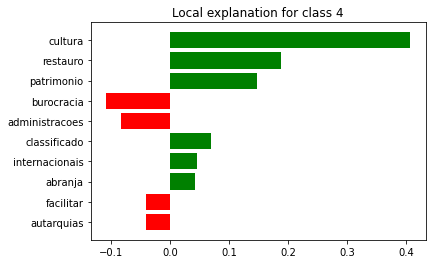

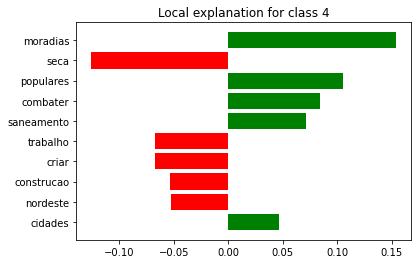

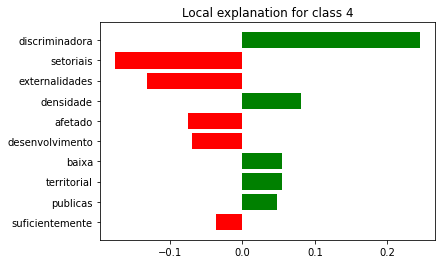

In [19]:
start = time.time()
class_exp = submodular_pick.SubmodularPick(explainer, class_sample[text_column].tolist(), predict_probs
                                           , sample_size=25
                                           , num_features=10
                                           , num_exps_desired=3)

print(f"\nLevou {math.ceil((time.time() - start)/60)} min para ser treinado.")

figs = [exp.as_pyplot_figure(label=exp.available_labels()[0]) for exp in class_exp.sp_explanations];

In [20]:
[f.savefig(f"/content/drive/MyDrive/UnB/TCC/resultados/domain_5_exp{i+1}.png", bbox_inches='tight', dpi=300) for i, f in enumerate(figs)];

### 4

In [32]:
class_sample = domain_df[domain_df['DOMAIN_CODE'] == 4].sample(100)
class_sample['DOMAIN_CODE_PRED'] = model.predict(list(class_sample['TEXT_TOKEN']))[0]

In [35]:
sample = class_sample[(class_sample['DOMAIN_CODE'] == 4) & (class_sample['DOMAIN_CODE_PRED'] == 4)].sample(1)
# sample = class_sample[class_sample.index == 3981]
sample

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,DOMAIN_CODE_PRED
18931,180240_201410,conservacao e uso sustentavel da biodiversidad...,conservacao uso sustentavel biodiversidade urg...,conservacao usar sustentavel biodiversidade ur...,4,Economy,416.2,sustainability +,4


In [36]:
create_local_explanation(sample)

Create local explanation for document index: 18931
True class:
	4 - Economy
Predicted class:
	5


In [24]:
class_sample = class_sample[(class_sample['DOMAIN_CODE'] == 4) & (class_sample['DOMAIN_CODE_PRED'] == 3)]
class_sample

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,DOMAIN_CODE_PRED
34666,180310_201010,utilizar os investimentos do petroleo como ala...,utilizar investimentos petroleo alavanca avanc...,utilizar investimento petroleo alavanca avanco...,4,Economy,411,technology & infrastructure,3
43895,35060_201510,a) do lancamento de concursos que valorizem o...,lancamento concursos valorizem conhecimento pr...,lancamento concurso valorizar conhecimento pro...,4,Economy,411,technology & infrastructure,3
42268,180710_199410,"e ainda resta o ouro primario, agregado as roc...",resta ouro primario agregado rochas matrizes,restar ourar primario agregar rocha matriz,4,Economy,411,technology & infrastructure,3
89337,35520_201910,a criacao de esquemas tarifarios dinamicos per...,criacao esquemas tarifarios dinamicos permitir...,criacao esquema tarifarios dinamicos permitir ...,4,Economy,416.2,sustainability +,3
19842,180240_201410,"em terceiro lugar, avancamos na implement...",avancamos implementacao programas pesquisa des...,avancamos implementacao programar pesquisar de...,4,Economy,411,technology & infrastructure,3
...,...,...,...,...,...,...,...,...,...
69359,35311_200502,a qualidade dos recursos humanos nacionais,qualidade recursos humanos nacionais,qualidade recurso humano nacional,4,Economy,411,technology & infrastructure,3
6184,180230_199410,manutencao das areas vitais (barracao de pesca...,manutencao areas vitais barracao pesca atracad...,manutencao areas vital pescar atracadouro mora...,4,Economy,416.2,sustainability +,3
2421,180230_198911,multiplicaram-se as madeireiras.,multiplicaram madeireiras,multiplicar madeireiro,4,Economy,416.2,sustainability +,3
8207,180230_200210,colabora para a retomada do desenvolvimento su...,colabora retomada desenvolvimento sustentavel,colaborar retomar desenvolvimento sustentavel,4,Economy,416.2,sustainability +,3



Levou 32 min para ser treinado.


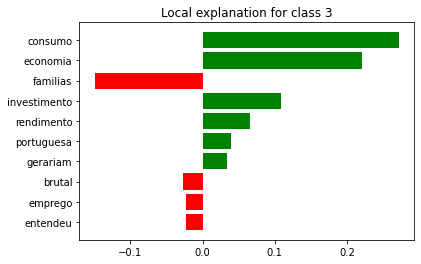

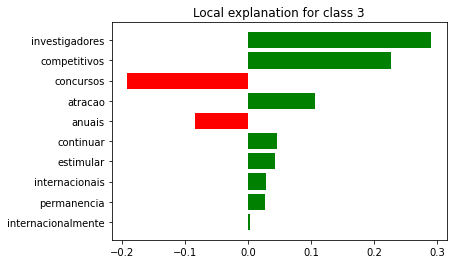

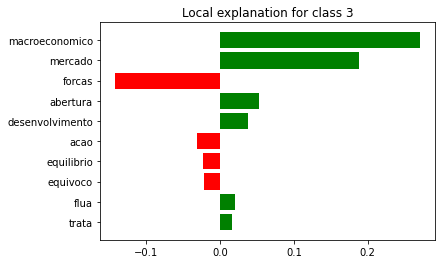

In [25]:
start = time.time()
class_exp = submodular_pick.SubmodularPick(explainer, class_sample[text_column].tolist(), predict_probs
                                           , sample_size=25
                                           , num_features=10
                                           , num_exps_desired=3)

print(f"\nLevou {math.ceil((time.time() - start)/60)} min para ser treinado.")

figs = [exp.as_pyplot_figure(label=exp.available_labels()[0]) for exp in class_exp.sp_explanations];

In [26]:
[f.savefig(f"/content/drive/MyDrive/UnB/TCC/resultados/domain_4_exp{i+1}.png", bbox_inches='tight', dpi=300) for i, f in enumerate(figs)];

In [16]:
class_sample = domain_df[domain_df['DOMAIN_CODE'] == 7].sample(100)
class_sample['DOMAIN_CODE_PRED'] = model.predict(list(class_sample['TEXT_TOKEN']))[0]

In [27]:
# sample = class_sample[(class_sample['DOMAIN_CODE'] == 7) & (class_sample['DOMAIN_CODE_PRED'] == 3)].sample(1)
sample = class_sample[class_sample.index == 87692]
sample

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,DOMAIN_CODE_PRED
87692,35520_201910,vamos promover a oferta de formacao em compete...,vamos promover oferta formacao competencias di...,ir promover ofertar formacao competencias digi...,7,Social Groups,701,labour groups +,3


In [28]:
create_local_explanation(sample)

Create local explanation for document index: 87692
True class:
	7 - Social Groups
Predicted class:
	4


In [29]:
sample = class_sample[(class_sample['DOMAIN_CODE'] == 7) & (class_sample['DOMAIN_CODE_PRED'] == 3)].sample(1)
# sample = class_sample[class_sample.index == 7833]
sample

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,DOMAIN_CODE_PRED
7833,180230_199810,recuperara substancialmente o poder aquisitivo...,recuperara substancialmente aquisitivo salario...,recuperar substancialmente aquisitivo salariar...,7,Social Groups,701,labour groups +,3


In [30]:
create_local_explanation(sample)

Create local explanation for document index: 7833
True class:
	7 - Social Groups
Predicted class:
	4


### Export global explanation for all classes


In [59]:
domain_df[f'{label_column}_PRED'] = model.predict(domain_df['TEXT_TOKEN'])
domain_df[[label_column, f'{label_column}_PRED']]

,DOMAIN_CODE,DOMAIN_CODE_PRED
4,2,2
5,2,3
6,2,2
8,2,2
10,5,5
...,...,...
90477,7,7
90478,7,7
90479,7,7
90480,2,2


In [62]:
def merge_exp_images(path, num_classes):
    path = path.replace('.', '')
    images = [Image.open(f"{path}_exp{i+1}.png") for i in range(num_classes)]
    widths, heights = zip(*(i.size for i in images))

    total_width = sum(widths)
    max_height = max(heights)

    new_im = Image.new('RGB', (total_width, max_height))

    x_offset = 0
    for im in images:
        new_im.paste(im, (x_offset,0))
        x_offset += im.size[0]

    new_im.save(f"{path}.jpg")

def create_global_explations(df, text_column, label_column):
    classes = df[label_column].unique()

    for cl in classes:
        class_sample = df[df[f'{label_column}_PRED'] == cl]

        start = time.time()
        class_exp = submodular_pick.SubmodularPick(explainer, class_sample[text_column].tolist(), predict_probs
                                                , sample_size=100
                                                , num_features=10
                                                , num_exps_desired=3)

        print(f"\nGeração da explicação globoal para a classe {cl} levou {math.ceil((time.time() - start)/60)} min.")
        figs = [exp.as_pyplot_figure(label=exp.available_labels()[0]) for exp in class_exp.sp_explanations];
        
        # save results
        path = f"/content/drive/MyDrive/UnB/TCC/resultados/domain_{str(cl).replace('.', '')}"
        [f.savefig(f"{path}_exp{i+1}.png", bbox_inches='tight', dpi=300) for i, f in enumerate(figs)];
        time.sleep(5)
        merge_exp_images(path, len(figs))


Geração da explicação globoal para a classe 2 levou 1 min.

Geração da explicação globoal para a classe 5 levou 1 min.

Geração da explicação globoal para a classe 7 levou 1 min.

Geração da explicação globoal para a classe 4 levou 1 min.

Geração da explicação globoal para a classe 6 levou 1 min.

Geração da explicação globoal para a classe 3 levou 1 min.

Geração da explicação globoal para a classe 1 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()


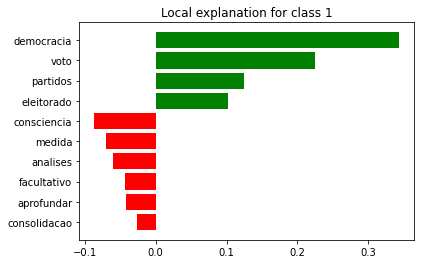

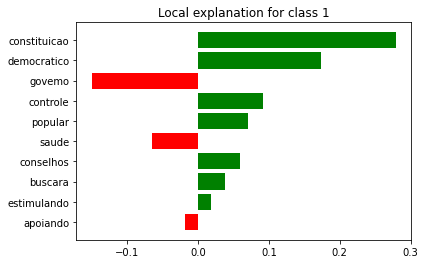

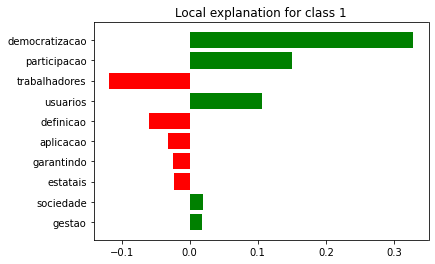

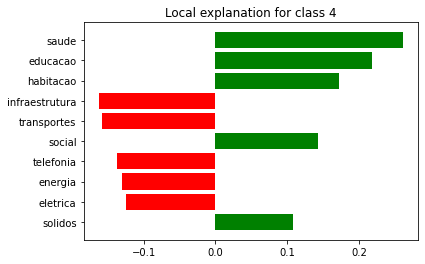

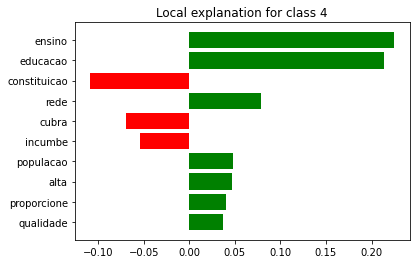

...

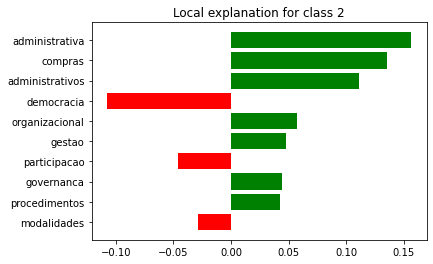

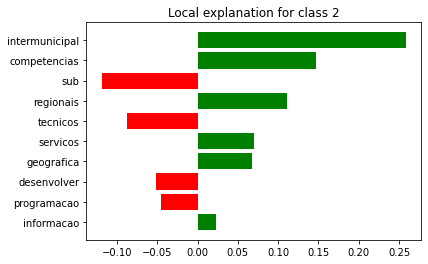

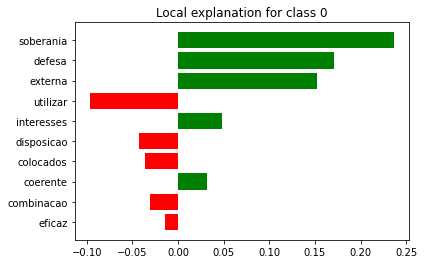

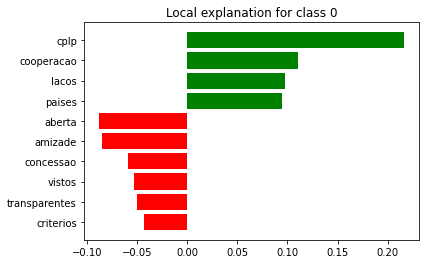

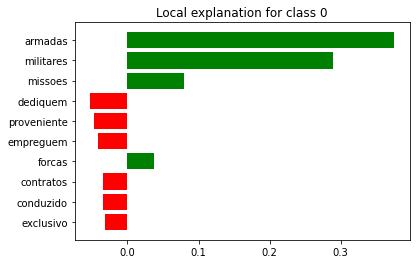

In [63]:
create_global_explations(domain_df, text_column, label_column)

## Code Explanation

In [7]:
text_column = "TEXT_TOKEN"
label_column = "CODE"

In [8]:
labels = list(model_code.classes_)
out = [print(i, v , ) for i, v in enumerate(labels)]

0 202.1
1 301.0
2 303.0
3 304.0
4 305.1
5 401.0
6 402.0
7 403.0
8 408.0
9 410.0
10 411.0
11 414.0
12 416.2
13 501.0
14 502.0
15 503.0
16 504.0
17 506.0
18 605.1
19 701.0
20 703.1


In [9]:
explainer = LimeTextExplainer(class_names=labels)

In [10]:
def create_local_explanation(sample):
    print(f'Create local explanation for document index: {sample.index.item()}')

    class_true = sample[label_column].item()
    print(f'True class:\n\t{class_true} - {sample["LABEL"].item()}')

    text = sample[text_column].item()
    class_pred = model_code.predict([text])[0]
    print(f"Predicted class:\n\t{class_pred}")
    # print(f'Document text:\n{text}')

    class_idx = []
    class_idx.append(labels.index(class_true))

    # if class was misclassificated, create both explanations
    if class_true != class_pred: 
        class_idx.append(labels.index(class_pred))
    
    print(class_idx)
    exp = explainer.explain_instance(text, predict_probs, num_features=5, labels=class_idx)

    # for cl in class_idx:
    #     print('Explanation for class %s' % labels[cl])
    #     out = [print(f'\t{e}') for e in sorted(exp.as_list(label=cl), key=lambda x: x[1], reverse=True)]

    print('\n')
    exp.show_in_notebook()

    return exp

### 408.0

In [ ]:
code_df.loc[code_df['CODE'] == '408.0', 'CODE_PRED'] = model_code.predict(code_df[code_df['CODE'] == '408.0']['TEXT_TOKEN'])

In [ ]:
# sample = code_df[(code_df['CODE'] == '408.0') & (code_df['CODE_PRED'] == '410.0')].sample(1)
sample = code_df[code_df.index == 54841]
sample

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,CODE_PRED
54841,35313_199910,"centrar a atencao nas politicas estruturais, c...",centrar atencao politicas estruturais objectiv...,centrar atencao politicar estruturar objectiva...,4,Economy,408.0,economic goals,410.0


In [ ]:
exp = create_local_explanation(sample)

Create local explanation for document index: 54841
True class:
	408.0 - economic goals
Predicted class:
	410.0
[8, 9]




In [ ]:
# sample = code_df[(code_df['CODE'] == '408.0') & (code_df['CODE_PRED'] == '411.0')].sample(1)
sample = code_df[code_df.index == 16634]
sample

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,CODE_PRED
16634,180310_199410,"populacao mais educada, novas tecnologias e um...",populacao educada tecnologias setor produtivo ...,populacao educar setor produtivo dinamico inov...,4,Economy,408.0,economic goals,411.0


In [ ]:
exp = create_local_explanation(sample)

Create local explanation for document index: 16634
True class:
	408.0 - economic goals
Predicted class:
	411.0
[8, 10]




In [ ]:
# sample = code_df[(code_df['CODE'] == '408.0') & (code_df['CODE_PRED'] == '408.0')].sample(1)
sample = code_df[code_df.index == 38086]
sample

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,CODE_PRED
38086,35211_201106,esta medida acerta com os credores da divida a...,medida acerta credores divida pagar periodo ca...,medir acertar credor dividir pagar periodo car...,4,Economy,408.0,economic goals,408.0


In [ ]:
exp = create_local_explanation(sample)

Create local explanation for document index: 38086
True class:
	408.0 - economic goals
Predicted class:
	408.0
[8]




In [ ]:
class_sample = code_df[code_df['CODE_PRED'] == '408.0']
class_sample

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,CODE_PRED
60,180230_198911,no primeiro fasciculo desta serie expusemos al...,fasciculo serie expusemos,fasciculo seriar expor,4,Economy,408.0,economic goals,408.0
288,180230_198911,"o assunto 'economia' abre a serie, que se desd...",assunto economia abre serie desdobra seguida f...,assunto abrir seriar desdobrar seguir fasciculos,4,Economy,408.0,economic goals,408.0
359,180230_198911,mas tem que vir acompanhada de uma serie de me...,vir acompanhada serie medidas correlatas comen...,ver acompanhar seriar medir correlatar comenta...,4,Economy,408.0,economic goals,408.0
1363,180230_198911,abastecer as industrias brasileiras com materi...,abastecer industrias brasileiras materias prim...,abastecer industriar brasileiro materias primo...,4,Economy,408.0,economic goals,408.0
1381,180230_198911,como dissemos no primeiro fasciculo desta seri...,dissemos fasciculo serie reavaliaremos projeto...,dizer fasciculo seriar reavaliar projeto eletr...,4,Economy,408.0,economic goals,408.0
...,...,...,...,...,...,...,...,...,...
63252,35520_201910,otimizacao dos custos de operacao e manutencao,otimizacao custos operacao manutencao,otimizacao custo operacao,4,Economy,408.0,economic goals,408.0
63650,35720_201910,acabar com a extorsao fiscal hoje praticada.,acabar extorsao fiscal hoje praticada,acabar extorsao fiscal hoje praticar,4,Economy,408.0,economic goals,408.0
63664,35720_201910,"finalmente, ao nivel da justica na cobranca de...",finalmente justica cobranca impostos taxa unic...,finalmente justica cobranca imposto taxar unic...,4,Economy,408.0,economic goals,408.0
63666,35720_201910,5.conta corrente entre o estado e o contribuinte.,conta contribuinte,contar contribuinte,4,Economy,408.0,economic goals,408.0



Levou 1 min para ser treinado.


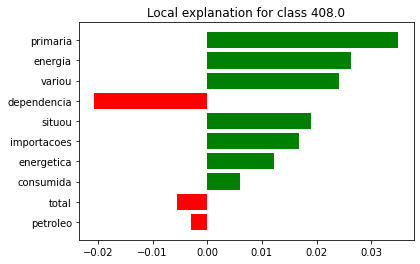

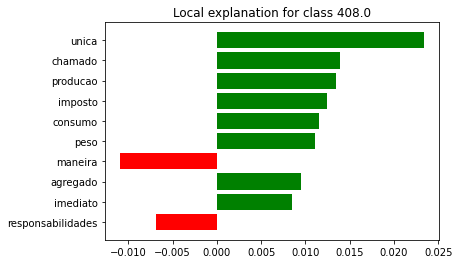

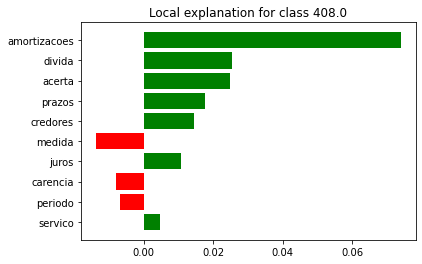

In [ ]:
start = time.time()
class_exp = submodular_pick.SubmodularPick(explainer, class_sample[text_column].tolist(), predict_probs
                                           , sample_size=100
                                           , num_features=10
                                           , num_exps_desired=3)

print(f"\nLevou {math.ceil((time.time() - start)/60)} min para ser treinado.")

figs = [exp.as_pyplot_figure(label=exp.available_labels()[0]) for exp in class_exp.sp_explanations];

In [ ]:
[f.savefig(f"/content/drive/MyDrive/UnB/TCC/resultados/code_408_exp{i+1}.png", bbox_inches='tight', dpi=300) for i, f in enumerate(figs)];

[None, None, None]

### 416.2 vs 501.0

In [ ]:
code = '416.2'
code_df.loc[code_df['CODE'] == code, 'CODE_PRED'] = model_code.predict(code_df[code_df['CODE'] == code]['TEXT_TOKEN'])

In [ ]:
code = '501.0'
code_df.loc[code_df['CODE'] == code, 'CODE_PRED'] = model_code.predict(code_df[code_df['CODE'] == code]['TEXT_TOKEN'])

In [ ]:
# sample = code_df[(code_df['CODE'] == '416.2') & (code_df['CODE_PRED'] == '501.0')].sample(1)
sample = code_df[code_df.index == 11744]
sample

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,CODE_PRED
11744,180240_200210,a) politica energetica em harmonia com as dete...,politica energetica harmonia determinantes amb...,politicar energetica harmonia determinante amb...,4,Economy,416.2,sustainability +,501.0


In [ ]:
exp = create_local_explanation(sample)

Create local explanation for document index: 11744
True class:
	416.2 - sustainability +
Predicted class:
	501.0
[12, 13]




In [ ]:
# sample = code_df[(code_df['CODE'] == '501.0') & (code_df['CODE_PRED'] == '416.2')].sample(1)
sample = code_df[code_df.index == 34487]
sample

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,CODE_PRED
34487,35120_201510,"nos solos ha diversos mecanismos ecologicos, c...",solos diversos mecanismos ecologicos ciclos ma...,solo diverso mecanismo ecologicos ciclo materi...,5,Welfare and Quality of Life,501.0,environmentalism +,416.2


In [ ]:
exp = create_local_explanation(sample)

Create local explanation for document index: 34487
True class:
	501.0 - environmentalism +
Predicted class:
	416.2
[13, 12]




In [ ]:
# sample = code_df[(code_df['CODE'] == '416.2') & (code_df['CODE_PRED'] == '416.2')].sample(1)
sample = code_df[code_df.index == 53232] 
sample

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,CODE_PRED
53232,35311_201910,desenvolver indices de sustentabilidade para a...,desenvolver indices sustentabilidade cidades c...,desenvolver indices sustentabilidade cidade co...,4,Economy,416.2,sustainability +,416.2


In [ ]:
exp = create_local_explanation(sample)

Create local explanation for document index: 53232
True class:
	416.2 - sustainability +
Predicted class:
	416.2
[12]




In [ ]:
# sample = code_df[(code_df['CODE'] == '501.0') & (code_df['CODE_PRED'] == '501.0')].sample(1)
sample = code_df[code_df.index == 33850] # 33732
sample 

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,CODE_PRED
33850,35110_201910,apesar de nos ultimos 4 anos ter sido possivel...,apesar ultimos anos sido intervencao pev contr...,apesar ultimos ano ser intervencao pev contrat...,5,Welfare and Quality of Life,501.0,environmentalism +,501.0


In [ ]:
exp = create_local_explanation(sample)

Create local explanation for document index: 33850
True class:
	501.0 - environmentalism +
Predicted class:
	501.0
[13]




In [16]:
class_sample = code_df[code_df['CODE_PRED'] == '416.2']
class_sample

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,CODE_PRED
16,180110_201010,"aumento em 10%, ate 2014, da participacao das ...",aumento participacao energias renovaveis matri...,aumentar participacao energia renovaveis matri...,5,Welfare and Quality of Life,501.0,environmentalism +,416.2
24,180110_201010,plano de geracao de empreos verdes na transica...,plano geracao empreos verdes transicao economi...,planar empreos verde transicao economia carbono,5,Welfare and Quality of Life,501.0,environmentalism +,416.2
35,180110_201010,apresentacao de plano nacional para agricultur...,apresentacao plano nacional agricultura susten...,apresentacao agricultura sustentavel,4,Economy,416.2,sustainability +,416.2
57,180230_198911,mas a ditadura do poder economico continua.,ditadura economico continua,ditadura economico continuar,5,Welfare and Quality of Life,503.0,equality +,416.2
64,180230_198911,sem agredir o meio ambiente.,agredir ambiente,agredir ambientar,4,Economy,416.2,sustainability +,416.2
...,...,...,...,...,...,...,...,...,...
63545,35720_201910,a optima gestao dos recursos comuns,optima gestao recursos comuns,optima gestao recurso comum,4,Economy,416.2,sustainability +,416.2
63840,35720_201910,nestes sentido toda a actividade economica ser...,nestes sentido actividade economica regulada t...,nestes sentir actividade economica regular ter...,4,Economy,416.2,sustainability +,416.2
63844,35720_201910,i.4.2.aposta numa economia progressivamente me...,aposta economia progressivamente dependente pe...,aposto economia progressivamente dependente pe...,4,Economy,416.2,sustainability +,416.2
63847,35720_201910,i.4.5.investir na ampliacao dos recursos estra...,investir ampliacao recursos estrategicos agua ...,investir ampliacao recurso estrategicos aguar ...,4,Economy,416.2,sustainability +,416.2



Levou 1 min para ser treinado.


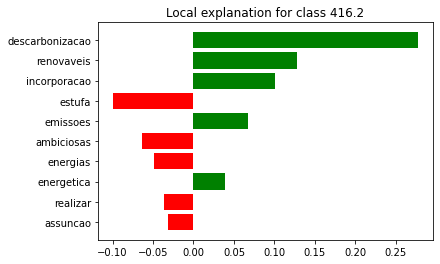

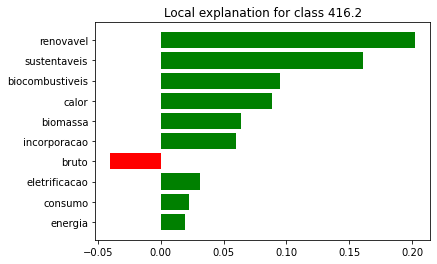

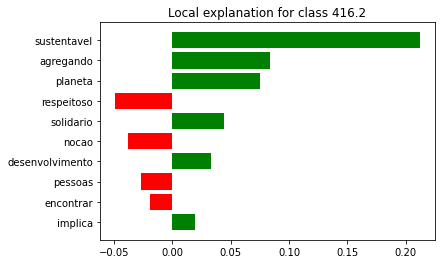

In [17]:
start = time.time()
class_exp = submodular_pick.SubmodularPick(explainer, class_sample[text_column].tolist(), predict_probs
                                           , sample_size=100
                                           , num_features=10
                                           , num_exps_desired=3)

print(f"\nLevou {math.ceil((time.time() - start)/60)} min para ser treinado.")

figs = [exp.as_pyplot_figure(label=exp.available_labels()[0]) for exp in class_exp.sp_explanations];

In [23]:
[f.savefig(f"/content/drive/MyDrive/UnB/TCC/resultados/code_4162_exp{i+1}.png", bbox_inches='tight', dpi=300) for i, f in enumerate(figs)];

In [ ]:
class_sample = code_df[code_df['CODE_PRED'] == '501.0']
class_sample

,MANIFEST_ID,TEXT,TEXT_TOKEN,TEXT_LEMMA,DOMAIN_CODE,DOMAIN_NAME,CODE,LABEL,CODE_PRED
13,180110_201010,agencia reguladora independente para a politic...,agencia reguladora independente politica nacio...,agenciar regulador independente politicar naci...,5,Welfare and Quality of Life,501.0,environmentalism +,501.0
14,180110_201010,publicacao de estimativas anuais de emissoes d...,publicacao estimativas anuais emissoes gases e...,publicacao estimativo anuir emissoes gas efeit...,5,Welfare and Quality of Life,501.0,environmentalism +,501.0
15,180110_201010,estabelecimento de indicadores de intensidade ...,estabelecimento indicadores intensidade emisso...,estabelecimento indicador intensidade emissoes...,5,Welfare and Quality of Life,501.0,environmentalism +,501.0
17,180110_201010,fim dos leiloes de energia para novas termoele...,leiloes energia termoeletricas movidas oleo di...,energia termoeletricas movido oleo diesel carv...,5,Welfare and Quality of Life,501.0,environmentalism +,501.0
19,180110_201010,supressao do ipi sobre fabricacao de veiculos ...,supressao ipi fabricacao veiculos eletricos hi...,supressao ipi veiculos eletricos hibridos,5,Welfare and Quality of Life,501.0,environmentalism +,501.0
...,...,...,...,...,...,...,...,...,...
63856,35720_201910,i.4.15.recuperacao da profissao de guarda flor...,recuperacao profissao guarda florestal primord...,recuperacao profissao guardar florestal primor...,5,Welfare and Quality of Life,501.0,environmentalism +,501.0
63857,35720_201910,criacao do posto de adjunto de guarda floresta...,criacao posto adjunto guarda florestal podendo...,criacao postar adjunto guardar florestal poder...,5,Welfare and Quality of Life,501.0,environmentalism +,501.0
63862,35720_201910,i.4.17.impossibilidade de construcao e obrigat...,impossibilidade construcao obrigatoriedade pla...,impossibilidade construcao obrigatoriedade pla...,5,Welfare and Quality of Life,501.0,environmentalism +,501.0
63887,35720_201910,k)incluir o patrimonio militar num plano de pr...,incluir patrimonio militar plano proteccao civ...,incluir patrimonio militar planar proteccao ci...,5,Welfare and Quality of Life,501.0,environmentalism +,501.0



Levou 1 min para ser treinado.


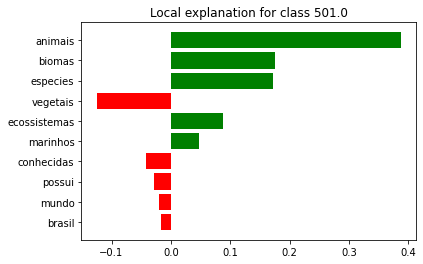

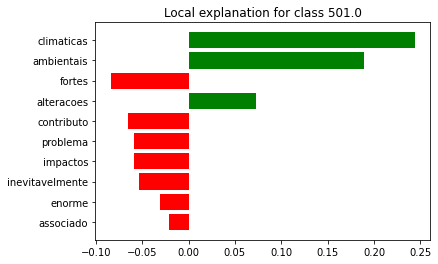

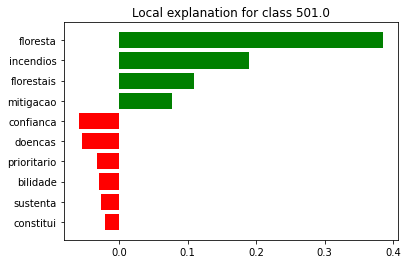

In [ ]:
start = time.time()
class_exp = submodular_pick.SubmodularPick(explainer, class_sample[text_column].tolist(), predict_probs
                                           , sample_size=100
                                           , num_features=10
                                           , num_exps_desired=3)

print(f"\nLevou {math.ceil((time.time() - start)/60)} min para ser treinado.")

figs = [exp.as_pyplot_figure(label=exp.available_labels()[0]) for exp in class_exp.sp_explanations];

In [ ]:
[f.savefig(f"/content/drive/MyDrive/UnB/TCC/resultados/code_501_exp{i+1}.png", bbox_inches='tight', dpi=300) for i, f in enumerate(figs)];

### Export global explanation for all classes



In [12]:
code_df['CODE_PRED'] = model_code.predict(code_df['TEXT_TOKEN'])
code_df[['CODE', 'CODE_PRED']]

,CODE,CODE_PRED
0,202.1,202.1
1,202.1,202.1
2,506.0,506.0
3,506.0,506.0
4,506.0,506.0
...,...,...
63914,401.0,402.0
63915,401.0,401.0
63916,401.0,401.0
63917,701.0,701.0


In [50]:
def merge_exp_images(path, num_classes):
    path = path.replace('.', '')
    images = [Image.open(f"{path}_exp{i+1}.png") for i in range(num_classes)]
    widths, heights = zip(*(i.size for i in images))

    total_width = sum(widths)
    max_height = max(heights)

    new_im = Image.new('RGB', (total_width, max_height))

    x_offset = 0
    for im in images:
        new_im.paste(im, (x_offset,0))
        x_offset += im.size[0]

    new_im.save(f"{path}.jpg")

def create_global_explations(df, text_column, label_column):
    classes = df[label_column].unique()

    for cl in classes:
        class_sample = df[df[f'{label_column}_PRED'] == cl]

        start = time.time()
        class_exp = submodular_pick.SubmodularPick(explainer, class_sample[text_column].tolist(), predict_probs
                                                , sample_size=100
                                                , num_features=10
                                                , num_exps_desired=3)

        print(f"\nGeração da explicação globoal para a classe {cl} levou {math.ceil((time.time() - start)/60)} min.")
        figs = [exp.as_pyplot_figure(label=exp.available_labels()[0]) for exp in class_exp.sp_explanations];
        
        # save results
        path = f"/content/drive/MyDrive/UnB/TCC/resultados/code_{cl.replace('.', '')}"
        [f.savefig(f"{path}_exp{i+1}.png", bbox_inches='tight', dpi=300) for i, f in enumerate(figs)];
        time.sleep(5)
        merge_exp_images(path, len(figs))


Geração da explicação globoal para a classe 202.1 levou 1 min.

Geração da explicação globoal para a classe 506.0 levou 1 min.

Geração da explicação globoal para a classe 701.0 levou 1 min.

Geração da explicação globoal para a classe 411.0 levou 1 min.

Geração da explicação globoal para a classe 504.0 levou 1 min.

Geração da explicação globoal para a classe 605.1 levou 1 min.

Geração da explicação globoal para a classe 501.0 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()



Geração da explicação globoal para a classe 503.0 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()



Geração da explicação globoal para a classe 416.2 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()



Geração da explicação globoal para a classe 303.0 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()



Geração da explicação globoal para a classe 403.0 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()



Geração da explicação globoal para a classe 502.0 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()



Geração da explicação globoal para a classe 301.0 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()



Geração da explicação globoal para a classe 305.1 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()



Geração da explicação globoal para a classe 408.0 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()



Geração da explicação globoal para a classe 703.1 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()



Geração da explicação globoal para a classe 304.0 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()



Geração da explicação globoal para a classe 410.0 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()



Geração da explicação globoal para a classe 414.0 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()



Geração da explicação globoal para a classe 402.0 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()



Geração da explicação globoal para a classe 401.0 levou 1 min.


/usr/local/lib/python3.7/dist-packages/lime/explanation.py:168: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()


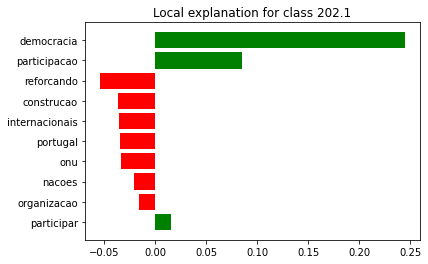

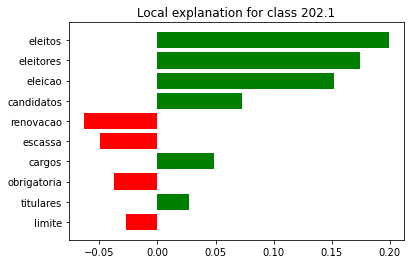

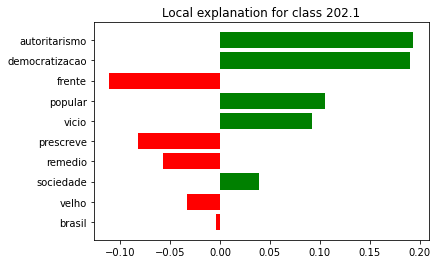

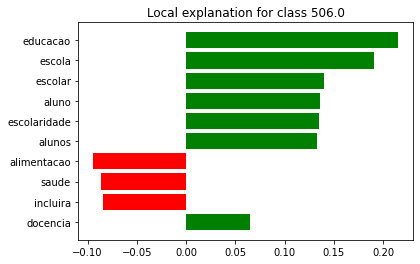

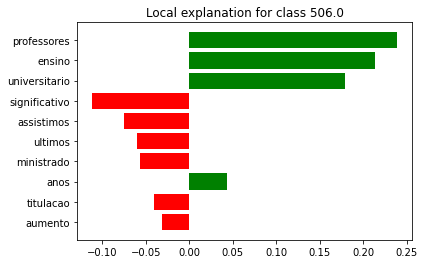

...

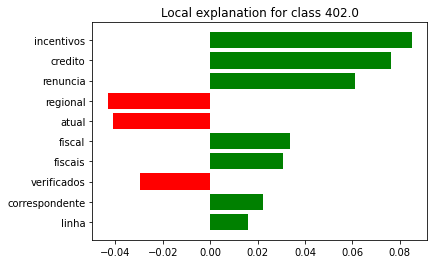

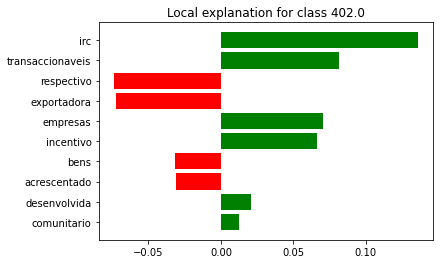

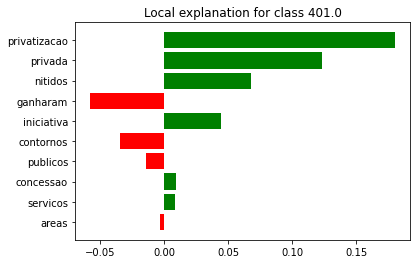

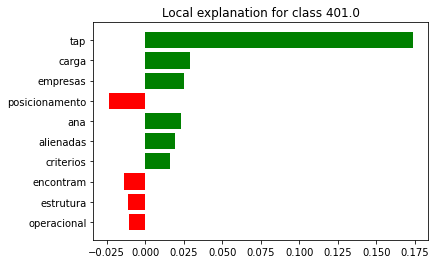

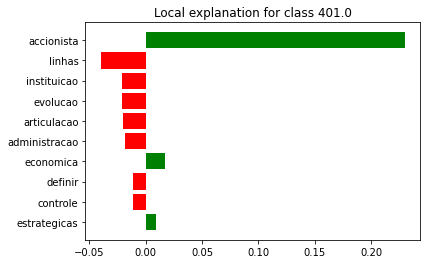

In [51]:
create_global_explations(code_df, text_column, label_column)